<a href="https://colab.research.google.com/github/petyoPopov/DataSystems/blob/master/VFU/Computer_Vision/01_Digital_ImagesPractice_Session_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Computer Vision Class - Practice Session 1
###done by Petyo Popov, winter 2020

## Task
*  Given an image find out its properties: Size, Color, Content

*  Given an image Save in another image only red channel
*  Given an image extract only certain range of grey level window and save them to a different image 
*  Given an image extract a region of interest (a subset) and save as another image. Describe what is the extracted region representing (optional)
*  Given several images combine them into a larger image (montage)


## Initial setup
I choose to do this task using Python and main libraries OpenCV2 and NumPy.
First I will load libraries, provide link to gitHub repo and load data.

In [1]:
#load libraries
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
import matplotlib.pyplot as plt

In [4]:
# Mount Google Drive
from google.colab import drive # import drive from google colab

ROOT = "/content/drive"     # default location for the drive
print(ROOT)                 # print content of ROOT (Optional)

drive.mount(ROOT)           # we mount the google drive at /content/drive

/content/drive
Mounted at /content/drive


In [6]:
#unzip files
import zipfile

local_zip = "/content/drive/MyDrive/Computer Vision/Practice session 1/Practice_Images_day1-20190902T081614Z-001.zip"
zip_ref = zipfile.ZipFile(local_zip , 'r')
zip_ref.extractall()
zip_ref.close()

In [156]:
#function to get the TIF files from the directory
def get_tif_files(photo_dir_path):
  file_list = []
  for i in os.listdir(photo_dir_path):
    #print(i[-3:])
    if i[-3:] == "tif":
      file_list.append(i)
  
  return file_list

In [157]:
#list files
photo_dir_path = "/content/Practice_Images_day1"
file_list = get_tif_files(photo_dir_path)

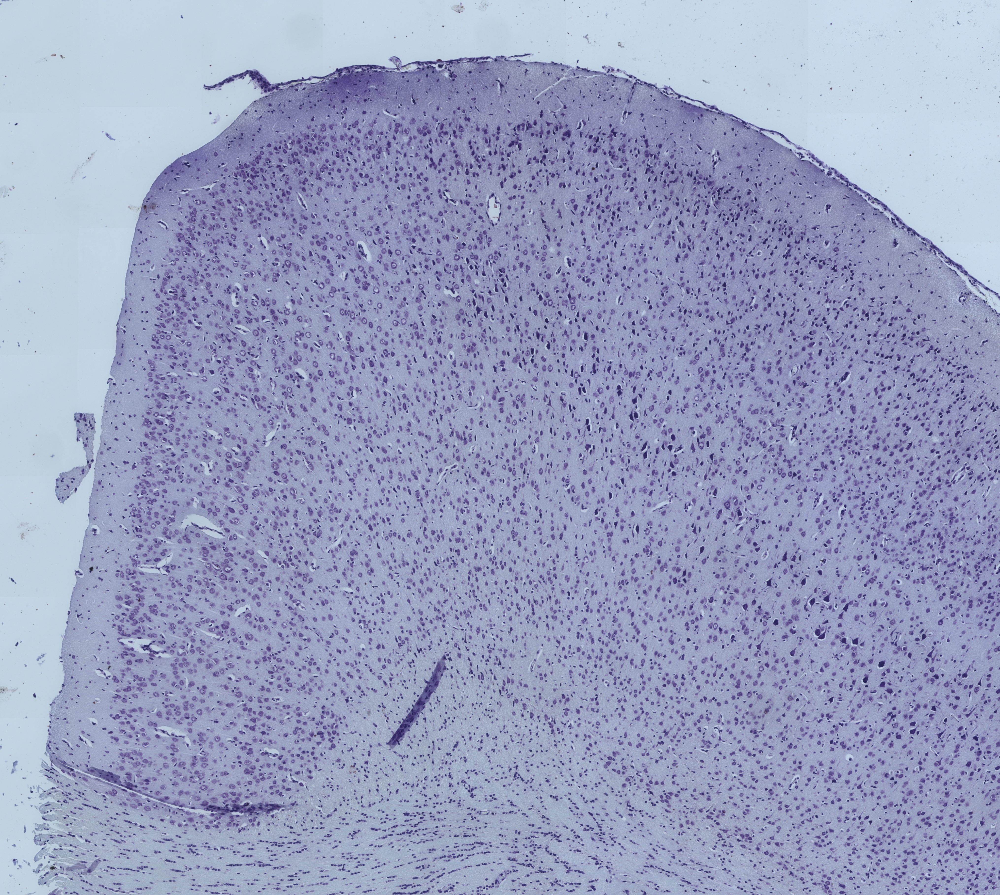

In [158]:
#show a photo
file_path = os.path.join(photo_dir_path , file_list[0])
img = cv2.imread(file_path)
cv2_imshow(img)

##Given an image find out its properties: Size, Color, Content


* Size
The size of an image depends on the number of pixels for height, width and the number of channels (Each channel represents a color component). Loading an image with OpenCV2, we read it in BGR channel order. If we want to send it to a system/library that works with RGB channel order, we have to transform it to an RGB image. 
** Below we will check the size of an image
** how many channels it has
** prepare and RGB image and present it with Matplotlib.



In [159]:
#Size
image_size = img.size
print("The number of pixels in the image is: ", image_size)
image_shape = img.shape
print("The shape of the image tensor is: ", image_shape)

The number of pixels in the image is:  44309571
The shape of the image tensor is:  (3637, 4061, 3)


In [160]:
#Color
channels = img.shape[-1]
print("The image has", channels, "channels")

The image has 3 channels


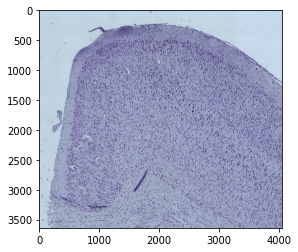

In [161]:
#convert the image in RGB and save it into a new var
img_rgb = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
#cv2_imshow(img_rgb)
plt.imshow(img_rgb)
plt.show()

In order to make computations a bit faster, the image will be re-sized of a quarter of its size. To do this a function will be made, which takes as input an image and a scale factor. For the re-scaling a OpenCV2 command will be used and the new pixels will be interpolated by resampling using pixel area relation.



In [162]:
#rescale images to a smaller size
def rescaleFrame(frame, scale=0.75):
  if scale >1:
    assert scale<1.0
  width = int(frame.shape[1] * scale)
  height = int(frame.shape[0] * scale)
  dimensions = (width, height)

  return cv2.resize(frame, dimensions, interpolation = cv2.INTER_AREA)

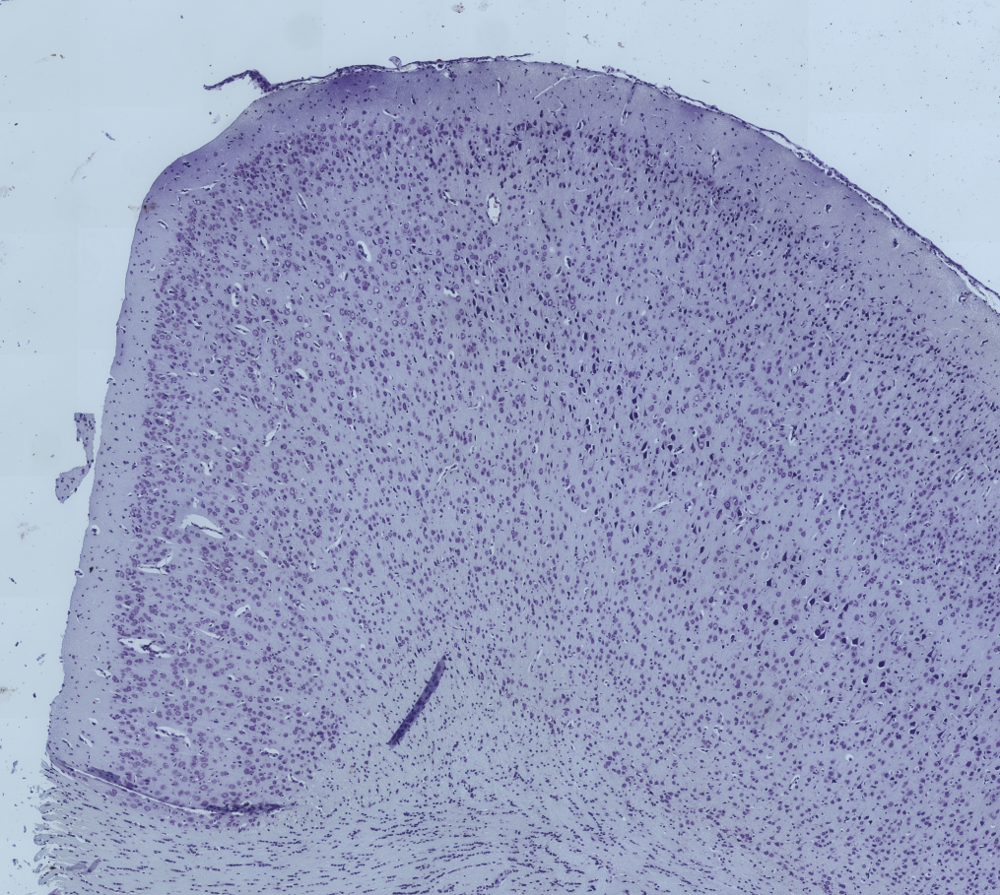

In [163]:
img = rescaleFrame(img, 0.25)
cv2_imshow(img)

In [164]:
#Content
#I dont know what is meant by content.

#Given an image Save in another image only red channel
The image we have loaded has 3 channels - Blue, Green, Red.
Each pixel is made by mixing the values of these 3 channels. If we save the data of only one channel to a new image and plot it, we will see a grayscale image. This is because we do not provide color mixing information. To visualize  only the red channel in its true color, we need to pass only this channels pixel intensity and 0 for all the rest.

* Show only red channel in greyscale

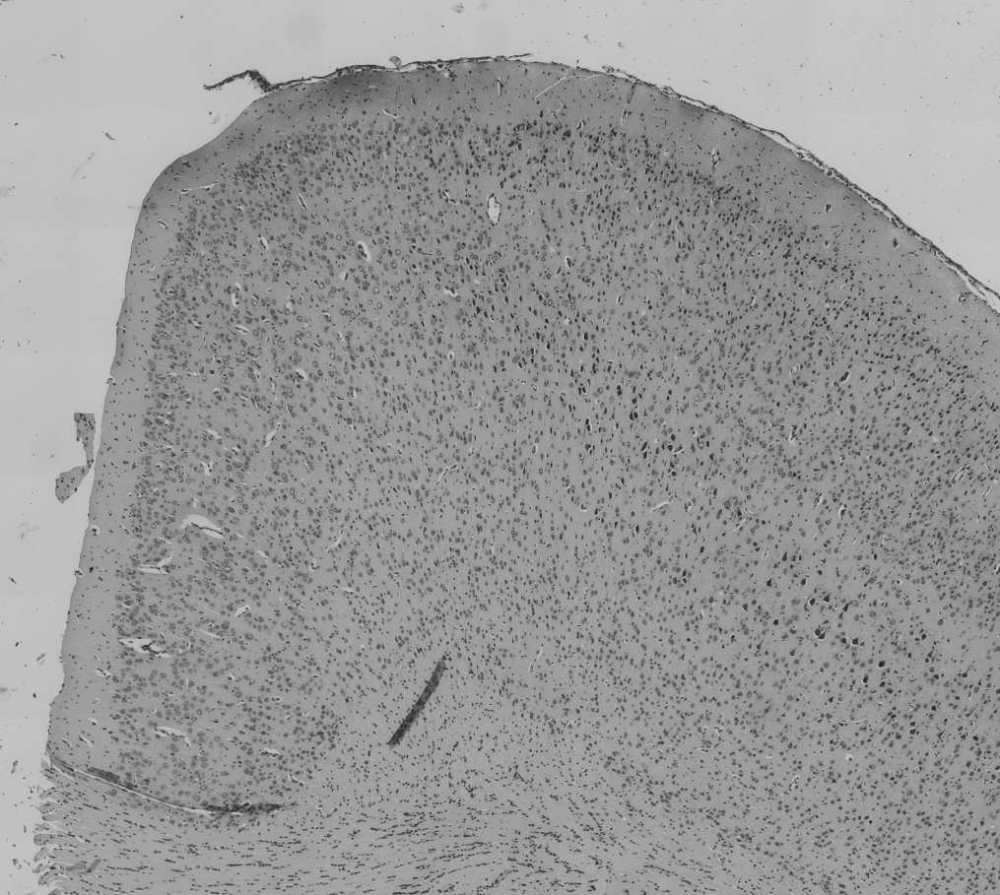

In [165]:
#save only the red channel and present it only
img_red = img[:,:,-1] #take only the last channel
cv2_imshow(img_red)

* Show only red channel in its ture color

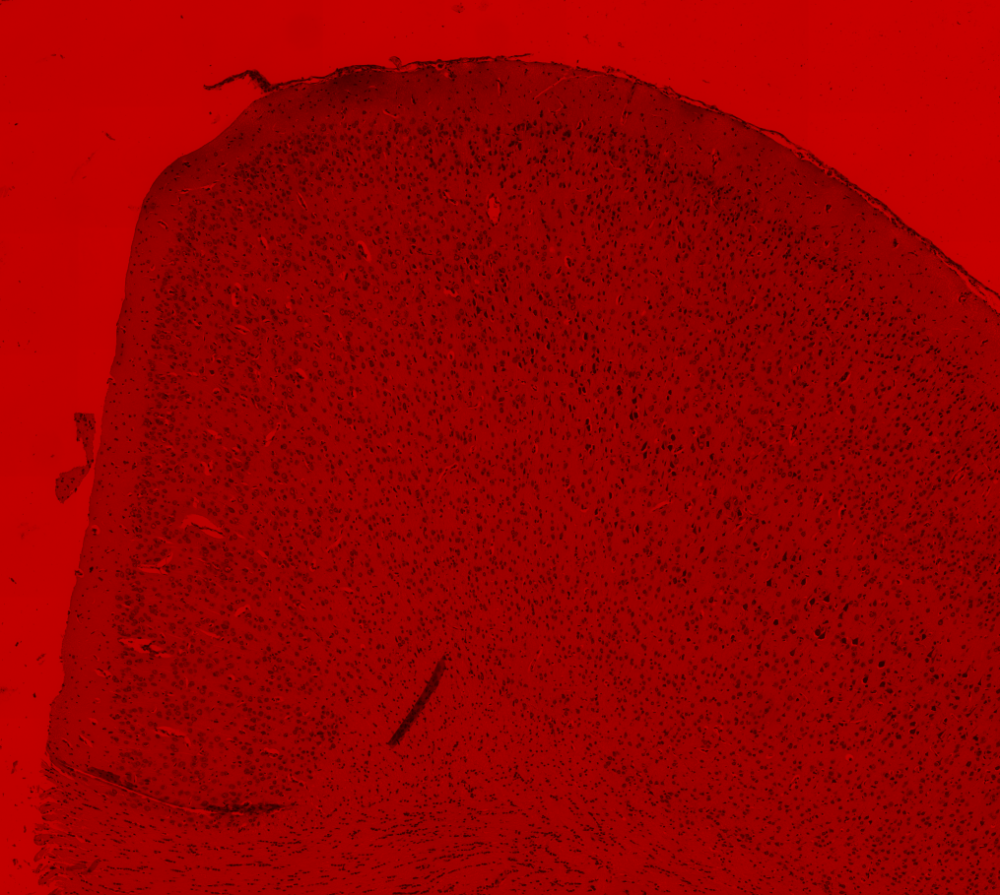

In [166]:
#save only the red channel of an image in a new var
blank = np.zeros(img.shape[:2], dtype = 'uint8') #blank to mask emptey channels
_, _, r = cv2.split(img) #the channel we want to save

img_red = cv2.merge([blank,blank,r]) #image with only wanter channel data

cv2_imshow(img_red)

#Given an image extract only certain range of grey level window and save them to a different image

* First we will convert the image in gray scale
* For the first image we will apply min and max level of grayscale. If a pixel integer is smaller its value will be substituted with the min value. If it is bigger than the max, values - it will be set to the max value.

* For the second image we will show only the pixels in the given range. The intensity of the rest will be set to 0, which will be presented as black.

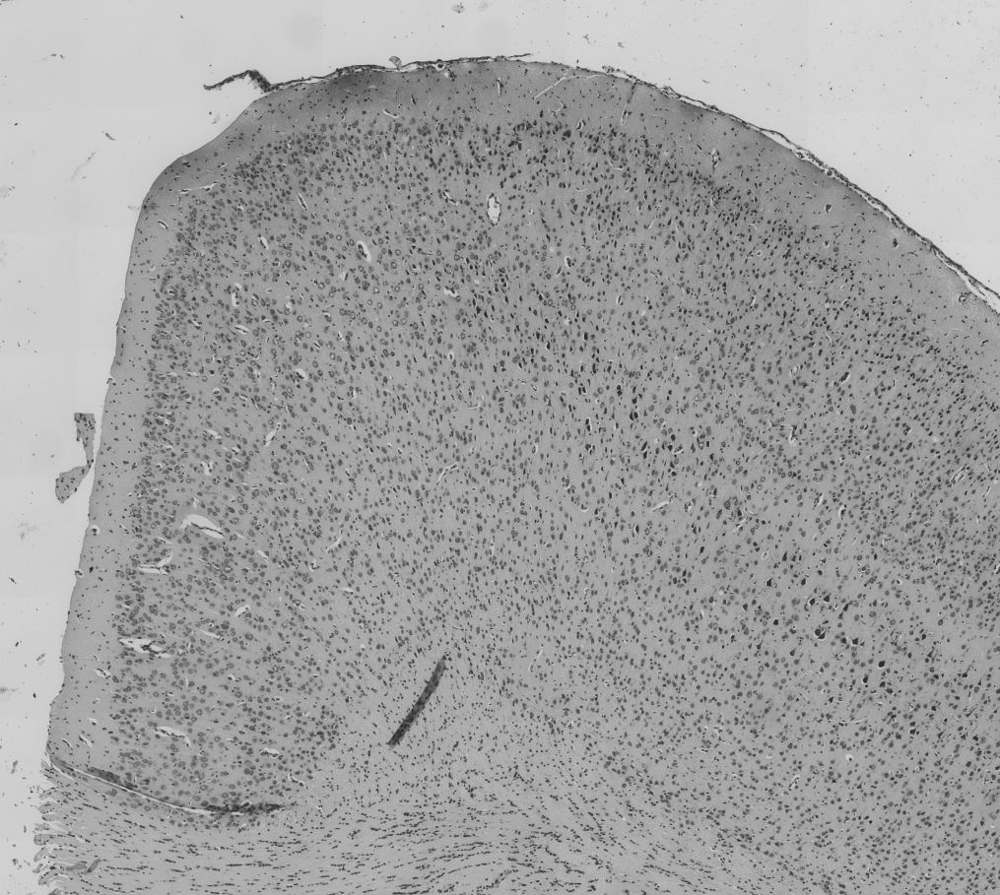

In [167]:
#convert the image to gray scale
img_grey = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(img_grey)

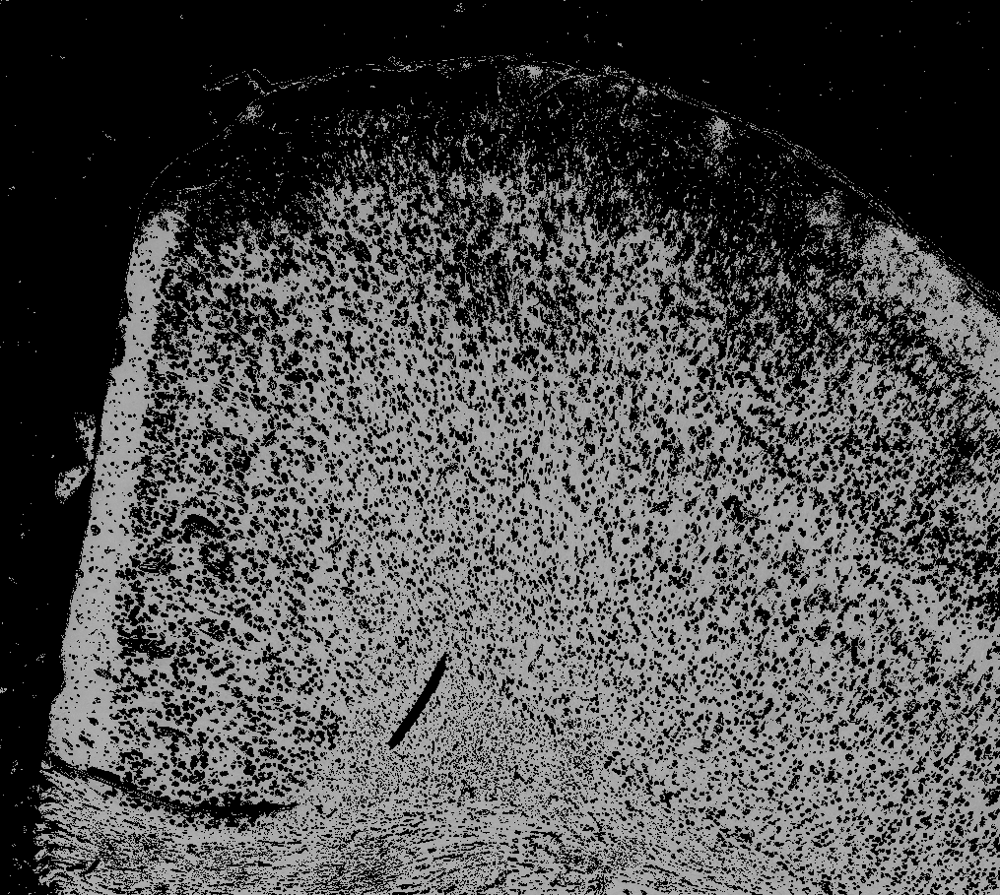

In [168]:
#save the image to a new file, apply min and max values. 
threshold = [150, 175] #min and max intensity of a pixel. 255 - bright, 0 
_, img_gray_thresh = cv2.threshold(img_grey, threshold[0], threshold[0], cv2.THRESH_TOZERO)
_, img_gray_thresh = cv2.threshold(img_gray_thresh, threshold[1], threshold[1], cv2.THRESH_TOZERO_INV)
cv2_imshow(img_gray_thresh)

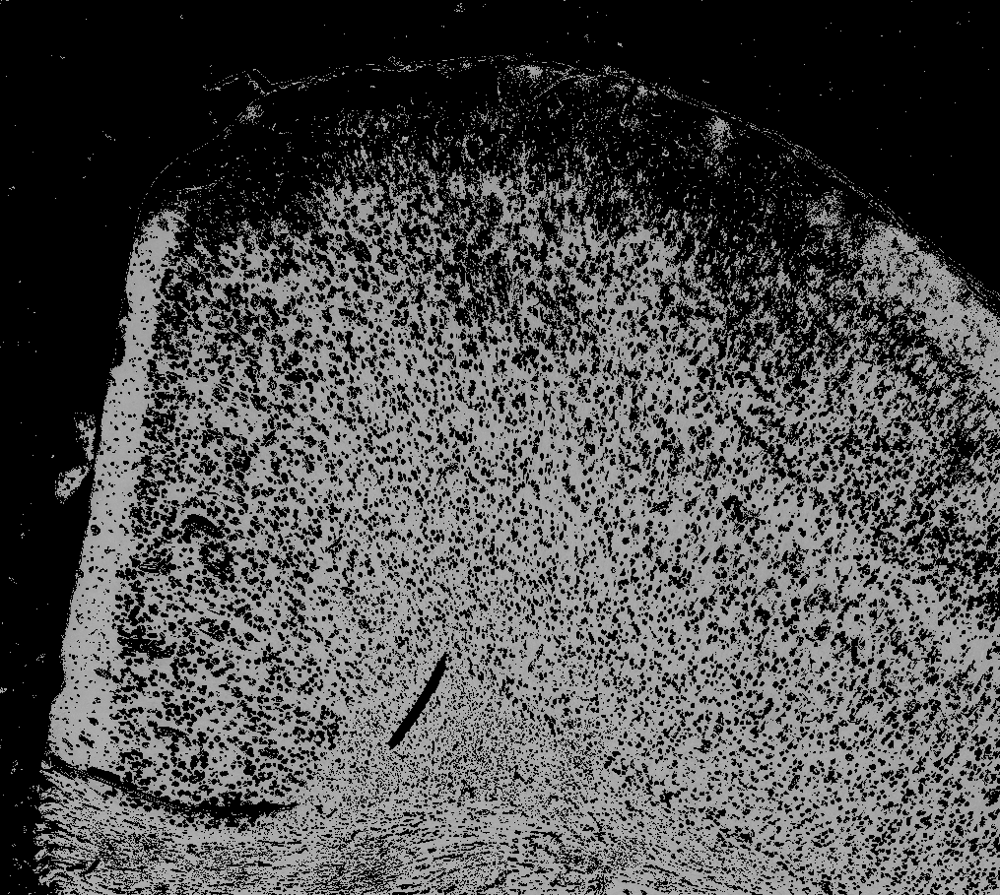

In [169]:
#show only a range of gray. The rest is 0
threshold = [150, 175] #min and max intensity of a pixel. 255 - bright, 0 
_, img_gray_thresh = cv2.threshold(img_grey, threshold[0], 0, cv2.THRESH_TOZERO)
_, img_gray_thresh = cv2.threshold(img_gray_thresh, threshold[1], 0, cv2.THRESH_TOZERO_INV)
cv2_imshow(img_gray_thresh)

#Given an image extract a region of interest (a subset) and save as another image. Describe what is the extracted region representing (optional)

If we imagine we divedie the heght and the width of the image by 3 separate rows and columns we will end up with 9 segment. Below we will crop the data only for the middle segment on the bottom row

$$\begin{bmatrix} 0 & 0 & 0 \\ 0 & 0 & 0 \\ 0 & X & 0 \end{bmatrix}$$


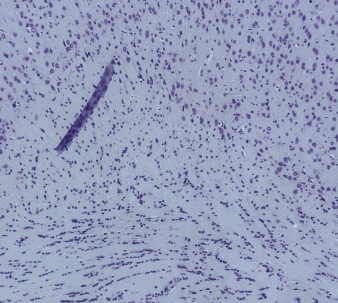

In [170]:
#save a portion of the image to a new file
small_shape = img.shape
img_small = img[small_shape[0]//3*2:,small_shape[1]//3:small_shape[1]//3*2,:]
cv2_imshow(img_small)

# Given several images combine them into a larger image (montage)
There are 6 images in the folder. A montage will be made of all of them, by arranging them in 2 rows and 3 columns. To make the montage nice and clean all images have to be of the same shape. 

To prepare the montage 3 helping functions will be made:
* func. for resizing a single image to a given size. Input: image , Returns image
* function to resize all images in a given list. Input: list of image locations, Returns a list of images
* function to provide a list of image paths.

Then first 3 images will be concatenated  in one row and 3 columns, and similar for the last 3.
The two rows will be then concatenated  vertically.
The end result will be presented.

In [171]:
#rescale all images to a single size

#function for resizing a single image
def resizeFrame(frame, size=[330, 330]):
  width = int(size[1])
  height = int(size[0])
  dimensions = (width, height)

  return cv2.resize(frame, dimensions, interpolation = cv2.INTER_CUBIC)

In [172]:
#function for resizing all images given in a list
def resizeImages(list, size=[330, 330]):
  new_list = []
  for i in list:
    new_image = resizeFrame(i, size)
    new_list.append(new_image)

  return new_list

In [173]:
#function to provide list of images given a list of files
def list_images(photo_dir_path , file_list):
  image_list = []
  for i in file_list:
    file_path = os.path.join(photo_dir_path , i)
    new_image = cv2.imread(file_path)
    image_list.append(new_image)
  
  return image_list

In [174]:
resized_images = resizeImages(list_images(photo_dir_path , file_list))

In [175]:
images_per_row = len(resized_images)//2
images_row1 = cv2.hconcat(resized_images[:images_per_row])
images_row2 = cv2.hconcat(resized_images[images_per_row:])
images_concat = cv2.vconcat([images_row1, images_row2])

In [177]:
print("The size of the image used for first row is: ", images_row1.shape)

The size of the image used for first row is:  (330, 990, 3)


In [181]:
print("The size of the image used for second row is: ", images_row2.shape)

The size of the image used for second row is:  (330, 990, 3)


In [182]:
print("The size of the image montage is: ", images_concat.shape)

The size of the image montage is:  (660, 990, 3)


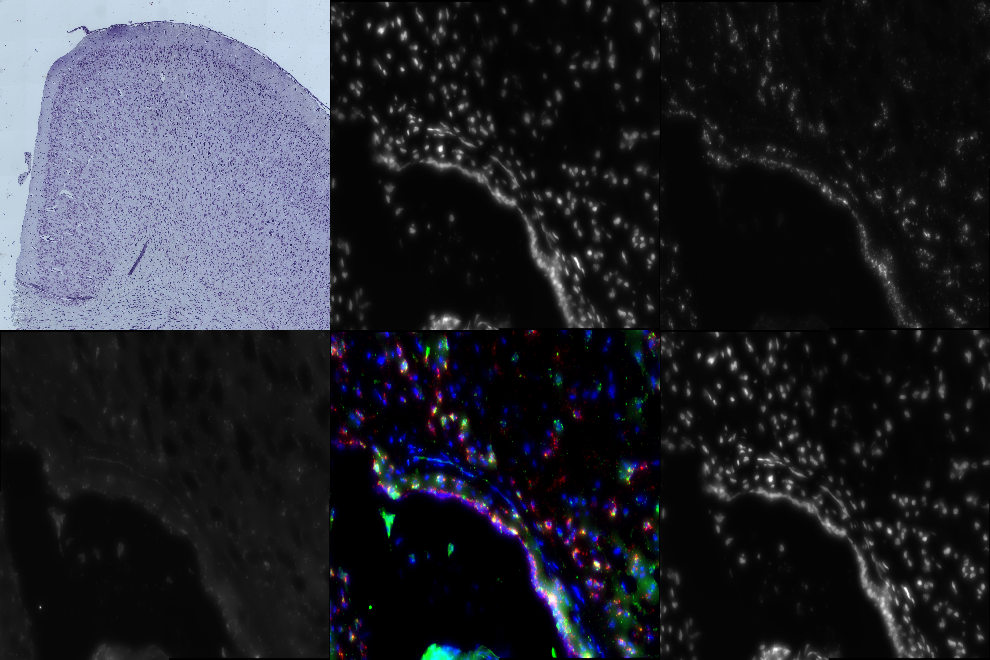

In [183]:
cv2_imshow(images_concat)